In [1]:
# Import Libraries
import pandas as pd
!pip install prophet
from prophet import Prophet
from prophet.plot import add_changepoints_to_plot
import warnings
warnings.filterwarnings("ignore")


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
coke_df = pd.read_csv("KO.csv")
coke_df.head(), coke_df.tail()


(         Date      Open      High       Low     Close  Adj Close    Volume
 0  1990-11-29  5.687500  5.734375  5.546875  5.593750   2.593405   6990400
 1  1990-11-30  5.593750  5.828125  5.562500  5.781250   2.680335  12562400
 2  1990-12-03  5.781250  5.875000  5.765625  5.843750   2.709311   8604800
 3  1990-12-04  5.843750  5.875000  5.703125  5.859375   2.716555   5730400
 4  1990-12-05  5.859375  5.953125  5.812500  5.937500   2.752775   6846400,
             Date       Open       High        Low      Close  Adj Close  \
 8307  2023-11-21  57.459999  58.040001  57.330002  58.029999  58.029999   
 8308  2023-11-22  58.259998  58.540001  58.130001  58.419998  58.419998   
 8309  2023-11-24  58.459999  58.750000  58.340000  58.570000  58.570000   
 8310  2023-11-27  58.540001  58.689999  58.270000  58.459999  58.459999   
 8311  2023-11-28  58.400002  58.830002  58.360001  58.580002  58.580002   
 
         Volume  
 8307  13891600  
 8308  11320600  
 8309   4816000  
 8310  162465

In [3]:
coke_df.shape


(8312, 7)

In [4]:
# Create df with date and price cols
coke_df = coke_df[["Date", "Close"]]
coke_df.head(), coke_df.tail()

(         Date     Close
 0  1990-11-29  5.593750
 1  1990-11-30  5.781250
 2  1990-12-03  5.843750
 3  1990-12-04  5.859375
 4  1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

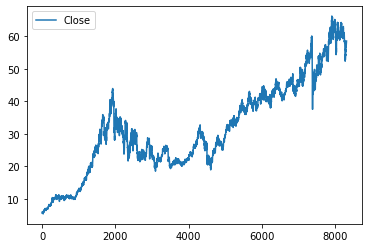

In [5]:
from matplotlib import pyplot
coke_df.plot()
pyplot.show()

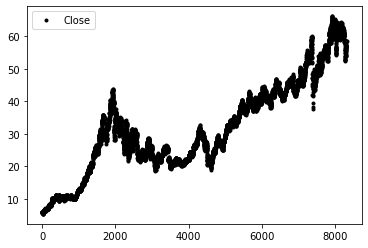

In [6]:
coke_df.plot(style='k.')
pyplot.show()

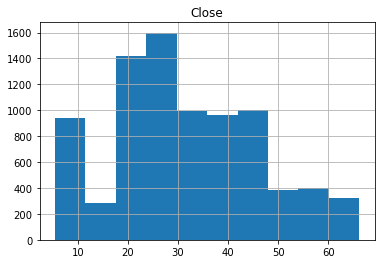

In [7]:
coke_df.hist()
pyplot.show()

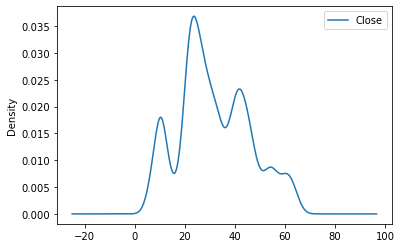

In [8]:
coke_df.plot(kind='kde')
pyplot.show()

In [9]:
coke_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8312 entries, 0 to 8311
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    8312 non-null   object 
 1   Close   8312 non-null   float64
dtypes: float64(1), object(1)
memory usage: 130.0+ KB


In [10]:
coke_stock_df = pd.DataFrame()
coke_stock_df['ds'] = pd.to_datetime(coke_df['Date'])
coke_stock_df['y'] = coke_df['Close']
coke_stock_df.head(), coke_df.tail()

(          ds         y
 0 1990-11-29  5.593750
 1 1990-11-30  5.781250
 2 1990-12-03  5.843750
 3 1990-12-04  5.859375
 4 1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

In [11]:
# Initialize model
prophet_model = Prophet(interval_width=0.95)
prophet_model.fit(coke_stock_df)

20:40:55 - cmdstanpy - INFO - Chain [1] start processing
20:40:58 - cmdstanpy - INFO - Chain [1] done processing


#  Forecast for 6 months

In [12]:
six_month_future = prophet_model.make_future_dataframe(periods=6*30, freq='D')

In [13]:
six_month_forecast = prophet_model.predict(six_month_future)

In [14]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].head()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
0,1990-11-29,6.231077,2.268760,10.845741,5.832525,5.832525,5.832525
1,1990-11-30,6.243267,1.565180,10.384784,5.840790,5.840790,5.840790
2,1990-12-03,6.264474,1.829017,10.372843,5.865586,5.865586,5.865586
3,1990-12-04,6.292977,1.911344,10.537427,5.873851,5.873851,5.873851
4,1990-12-05,6.303088,1.848269,10.554375,5.882116,5.882116,5.882116


In [15]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8487,2024-05-22,64.331602,60.027583,68.296046,63.797403,62.483926,64.841937
8488,2024-05-23,64.336526,59.775774,68.663557,63.805471,62.475487,64.857959
8489,2024-05-24,64.357536,59.664866,68.792463,63.813539,62.467048,64.873981
8490,2024-05-25,64.175528,59.597238,68.250643,63.821607,62.458610,64.889685
8491,2024-05-26,64.192926,59.443792,68.812113,63.829675,62.450171,64.905267


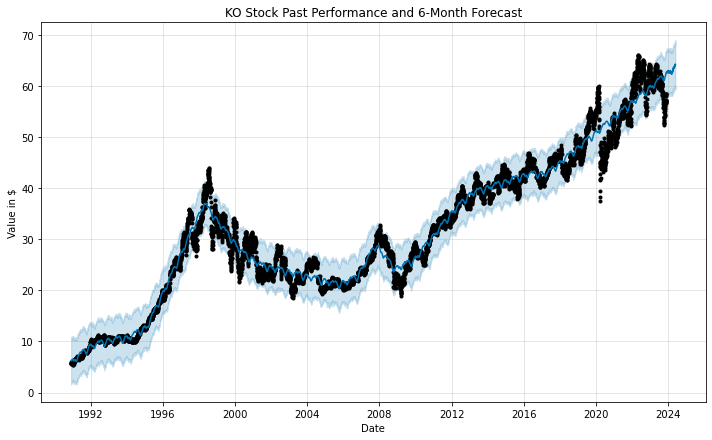

In [16]:
import matplotlib.pyplot as plt
trend_plot = prophet_model.plot(six_month_forecast)
plt.title('KO Stock Past Performance and 6-Month Forecast')
plt.xlabel('Date')
plt.ylabel('Value in $')

trend_plot.show()

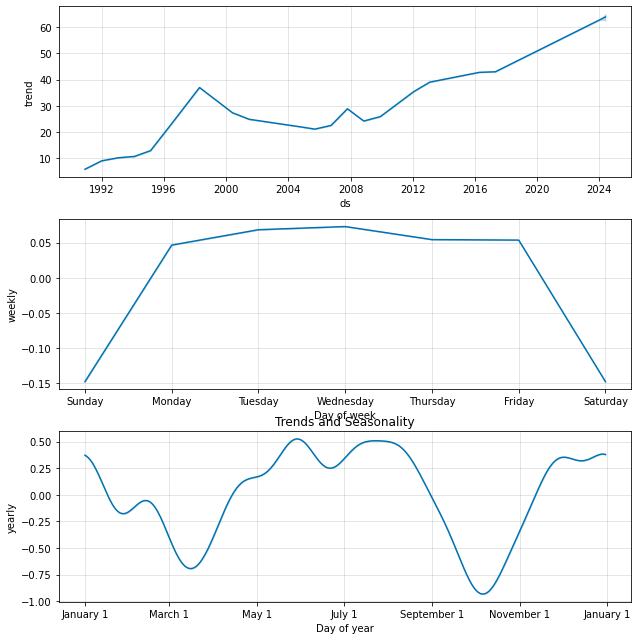

In [17]:
six_month_performance_plot = prophet_model.plot_components(six_month_forecast)
plt.title('Trends and Seasonality')
six_month_performance_plot.show()


[[<matplotlib.lines.Line2D at 0x223abd4dee0>],

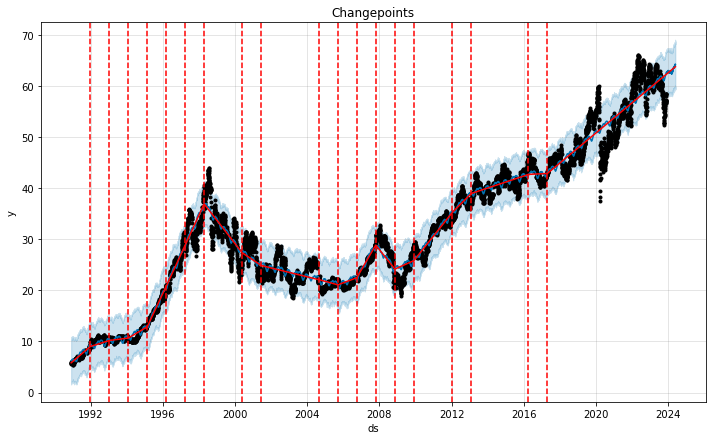

In [18]:
# Trends and seasonality
trend_plot = prophet_model.plot(six_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, six_month_forecast)
plt.title("Changepoints")
trends_and_seasonality_plot

In [19]:
from prophet.diagnostics import cross_validation
six_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

20:41:36 - cmdstanpy - INFO - Chain [1] start processing
20:41:36 - cmdstanpy - INFO - Chain [1] done processing
20:41:36 - cmdstanpy - INFO - Chain [1] start processing
20:41:36 - cmdstanpy - INFO - Chain [1] done processing
20:41:37 - cmdstanpy - INFO - Chain [1] start processing
20:41:37 - cmdstanpy - INFO - Chain [1] done processing
20:41:37 - cmdstanpy - INFO - Chain [1] start processing
20:41:37 - cmdstanpy - INFO - Chain [1] done processing
20:41:37 - cmdstanpy - INFO - Chain [1] start processing
20:41:38 - cmdstanpy - INFO - Chain [1] done processing
20:41:38 - cmdstanpy - INFO - Chain [1] start processing
20:41:38 - cmdstanpy - INFO - Chain [1] done processing
20:41:38 - cmdstanpy - INFO - Chain [1] start processing
20:41:39 - cmdstanpy - INFO - Chain [1] done processing
20:41:39 - cmdstanpy - INFO - Chain [1] start processing
20:41:39 - cmdstanpy - INFO - Chain [1] done processing
20:41:40 - cmdstanpy - INFO - Chain [1] start processing
20:41:40 - cmdstanpy - INFO - Chain [1]

In [20]:
six_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.507216,10.396669,9.812500,1993-05-04
1,1993-05-06,9.978941,9.530415,10.413715,9.718750,1993-05-04
2,1993-05-07,9.989581,9.534836,10.410649,9.687500,1993-05-04
3,1993-05-10,10.072743,9.656112,10.505491,9.781250,1993-05-04
4,1993-05-11,10.080418,9.636909,10.532006,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,56.346699,68.168396,58.029999,2022-11-28
15346,2023-11-22,62.445992,56.280320,67.996128,58.419998,2022-11-28
15347,2023-11-24,62.454819,56.858550,67.819038,58.570000,2022-11-28
15348,2023-11-27,62.475019,56.925491,68.124463,58.459999,2022-11-28


In [21]:
# Performance metrics
from prophet.diagnostics import performance_metrics
six_month_performance_df = performance_metrics(six_month_cv)
six_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.690978
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.687376
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.681619
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.679556
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.679100
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.723279
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.723344
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.724290
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.724337


In [25]:
six_month_performance_df.iloc[143], six_month_performance_df.iloc[328]


(horizon     180 days 00:00:00
 mse                  15.72961
 rmse                 3.966057
 mae                  3.136961
 mape                 0.105742
 mdape                0.084921
 smape                0.104647
 coverage             0.525798
 Name: 143, dtype: object,
 horizon     365 days 00:00:00
 mse                  26.62567
 rmse                 5.160007
 mae                  3.955674
 mape                 0.129944
 mdape                0.090121
 smape                0.127467
 coverage             0.727627
 Name: 328, dtype: object)

#  Forecast for 12 months

In [26]:
twelve_month_future = prophet_model.make_future_dataframe(periods=12*30, freq='D')

In [27]:
twelve_month_forecast = prophet_model.predict(twelve_month_future)

In [28]:
twelve_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8667,2024-11-18,65.469283,59.472909,70.414370,65.249626,61.481693,68.533490
8668,2024-11-19,65.524322,60.122627,70.727456,65.257694,61.474846,68.562994
8669,2024-11-20,65.560485,60.105252,70.931289,65.265762,61.468000,68.592240
8670,2024-11-21,65.571858,60.208852,71.734392,65.273830,61.461153,68.621485
8671,2024-11-22,65.599306,59.683952,70.871023,65.281898,61.454307,68.650731


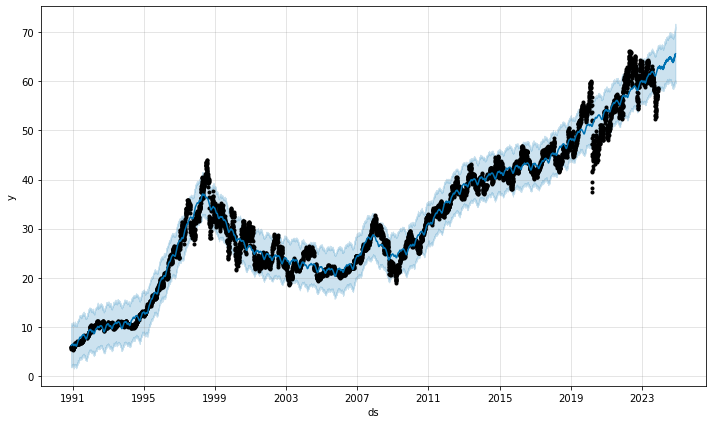

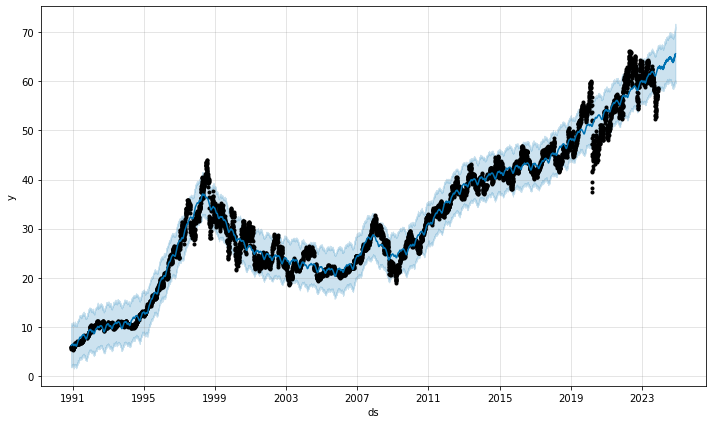

In [29]:
trend_plot = prophet_model.plot(twelve_month_forecast)
trend_plot

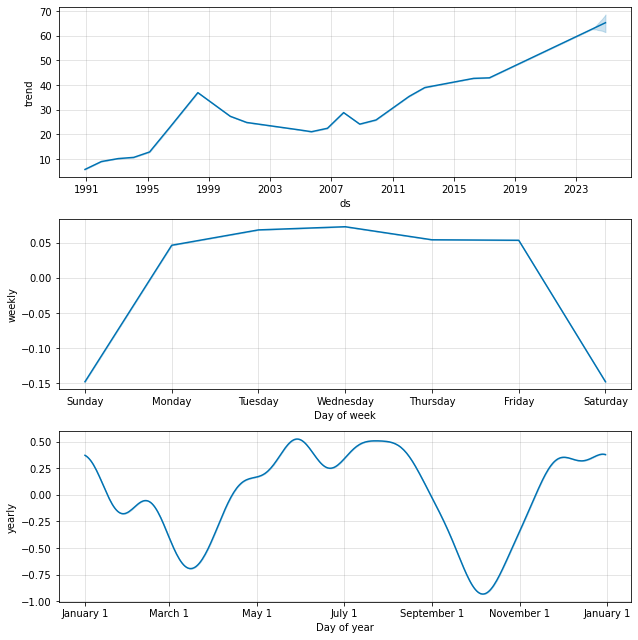

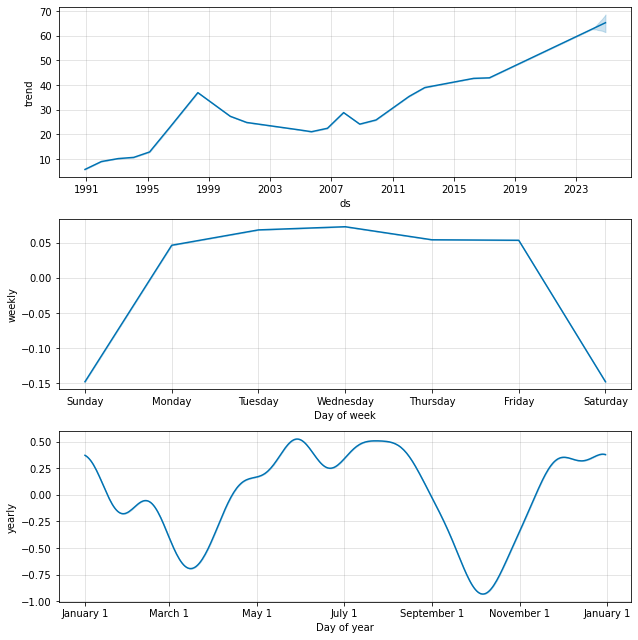

In [30]:
twelve_month_performance_plot = prophet_model.plot_components(twelve_month_forecast)
twelve_month_performance_plot


[[<matplotlib.lines.Line2D at 0x223b1642a90>],

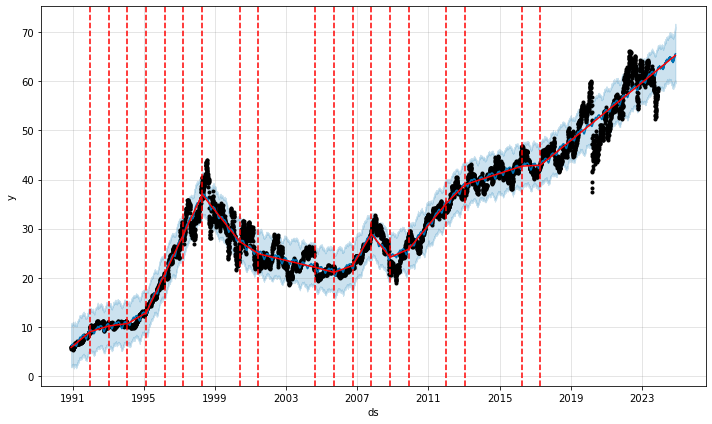

In [31]:
# Trends and seasonality
trend_plot = prophet_model.plot(twelve_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, twelve_month_forecast)
trends_and_seasonality_plot

In [32]:
from prophet.diagnostics import cross_validation
twelve_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

20:50:48 - cmdstanpy - INFO - Chain [1] start processing
20:50:48 - cmdstanpy - INFO - Chain [1] done processing
20:50:48 - cmdstanpy - INFO - Chain [1] start processing
20:50:49 - cmdstanpy - INFO - Chain [1] done processing
20:50:49 - cmdstanpy - INFO - Chain [1] start processing
20:50:49 - cmdstanpy - INFO - Chain [1] done processing
20:50:49 - cmdstanpy - INFO - Chain [1] start processing
20:50:49 - cmdstanpy - INFO - Chain [1] done processing
20:50:50 - cmdstanpy - INFO - Chain [1] start processing
20:50:50 - cmdstanpy - INFO - Chain [1] done processing
20:50:50 - cmdstanpy - INFO - Chain [1] start processing
20:50:50 - cmdstanpy - INFO - Chain [1] done processing
20:50:51 - cmdstanpy - INFO - Chain [1] start processing
20:50:51 - cmdstanpy - INFO - Chain [1] done processing
20:50:51 - cmdstanpy - INFO - Chain [1] start processing
20:50:52 - cmdstanpy - INFO - Chain [1] done processing
20:50:52 - cmdstanpy - INFO - Chain [1] start processing
20:50:52 - cmdstanpy - INFO - Chain [1]

In [33]:
twelve_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.509870,10.370628,9.812500,1993-05-04
1,1993-05-06,9.978941,9.547945,10.428679,9.718750,1993-05-04
2,1993-05-07,9.989581,9.533723,10.391425,9.687500,1993-05-04
3,1993-05-10,10.072743,9.652225,10.498360,9.781250,1993-05-04
4,1993-05-11,10.080418,9.653172,10.504085,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,56.744010,67.834250,58.029999,2022-11-28
15346,2023-11-22,62.445992,57.187917,67.551349,58.419998,2022-11-28
15347,2023-11-24,62.454819,57.183406,67.934280,58.570000,2022-11-28
15348,2023-11-27,62.475019,57.329355,67.763423,58.459999,2022-11-28


In [34]:
# Performance metrics
from prophet.diagnostics import performance_metrics
twelve_month_performance_df = performance_metrics(twelve_month_cv)
twelve_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.686418
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.683149
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.678362
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.675648
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.674237
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.714809
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.714875
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.716612
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.717977


# Forecast for 18 months

In [35]:
eighteen_month_future = prophet_model.make_future_dataframe(periods=18*30, freq='D')

In [36]:
eighteen_month_forecast = prophet_model.predict(eighteen_month_future)

In [37]:
eighteen_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8847,2025-05-17,66.915720,59.669099,74.845587,66.701849,59.392205,73.362693
8848,2025-05-18,66.943933,59.066592,75.189175,66.709917,59.377025,73.396038
8849,2025-05-19,67.166473,58.871542,74.911484,66.717985,59.361845,73.429383
8850,2025-05-20,67.215786,59.306394,75.435599,66.726052,59.346665,73.462728
8851,2025-05-21,67.246874,59.106180,75.211018,66.734120,59.331485,73.496073


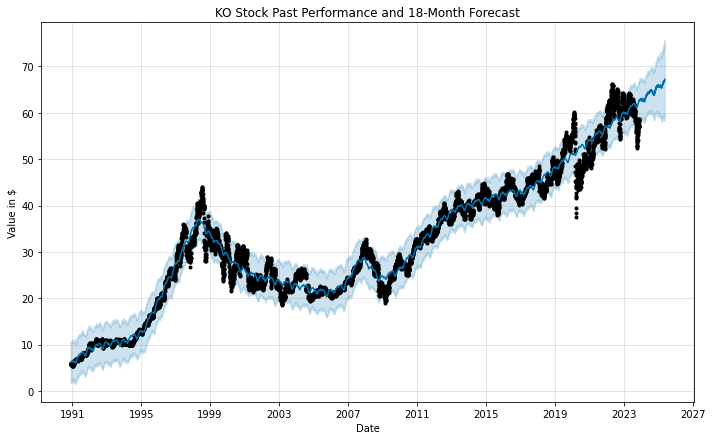

In [38]:
trend_plot = prophet_model.plot(eighteen_month_forecast)
plt.title('KO Stock Past Performance and 18-Month Forecast')
plt.xlabel('Date')
plt.ylabel('Value in $')

trend_plot.show()

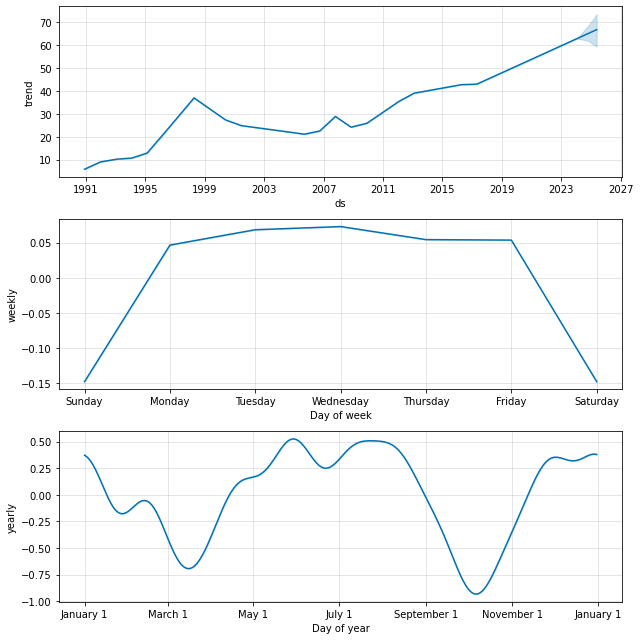

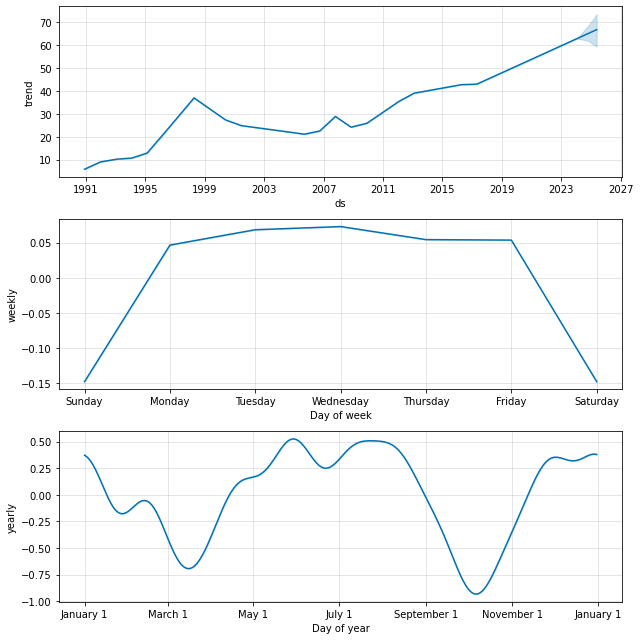

In [39]:
eighteen_month_performance_plot = prophet_model.plot_components(eighteen_month_forecast)
eighteen_month_performance_plot

[[<matplotlib.lines.Line2D at 0x223b2156070>],

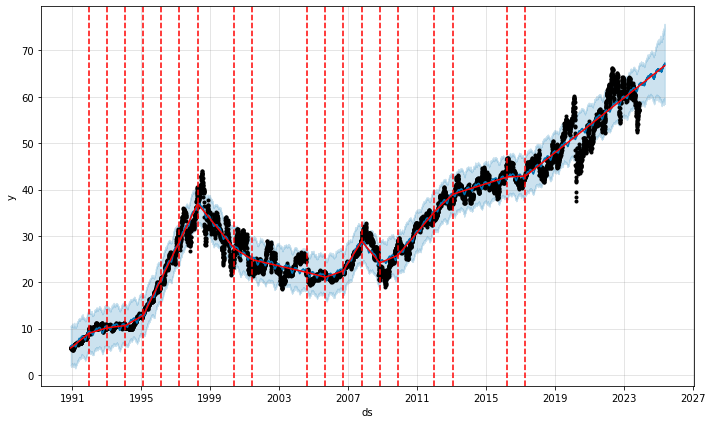

In [40]:
# Trends and seasonality
trend_plot = prophet_model.plot(eighteen_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       prophet_model, eighteen_month_forecast)
trends_and_seasonality_plot

In [41]:
from prophet.diagnostics import cross_validation
eighteen_month_cv = cross_validation(prophet_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

20:53:03 - cmdstanpy - INFO - Chain [1] start processing
20:53:03 - cmdstanpy - INFO - Chain [1] done processing
20:53:03 - cmdstanpy - INFO - Chain [1] start processing
20:53:03 - cmdstanpy - INFO - Chain [1] done processing
20:53:04 - cmdstanpy - INFO - Chain [1] start processing
20:53:04 - cmdstanpy - INFO - Chain [1] done processing
20:53:04 - cmdstanpy - INFO - Chain [1] start processing
20:53:04 - cmdstanpy - INFO - Chain [1] done processing
20:53:04 - cmdstanpy - INFO - Chain [1] start processing
20:53:05 - cmdstanpy - INFO - Chain [1] done processing
20:53:05 - cmdstanpy - INFO - Chain [1] start processing
20:53:05 - cmdstanpy - INFO - Chain [1] done processing
20:53:05 - cmdstanpy - INFO - Chain [1] start processing
20:53:06 - cmdstanpy - INFO - Chain [1] done processing
20:53:06 - cmdstanpy - INFO - Chain [1] start processing
20:53:06 - cmdstanpy - INFO - Chain [1] done processing
20:53:07 - cmdstanpy - INFO - Chain [1] start processing
20:53:07 - cmdstanpy - INFO - Chain [1]

In [42]:
eighteen_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.939147,9.506620,10.362984,9.812500,1993-05-04
1,1993-05-06,9.978941,9.558538,10.400114,9.718750,1993-05-04
2,1993-05-07,9.989581,9.557165,10.427678,9.687500,1993-05-04
3,1993-05-10,10.072743,9.635909,10.527171,9.781250,1993-05-04
4,1993-05-11,10.080418,9.607985,10.515210,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.427187,56.687990,68.401742,58.029999,2022-11-28
15346,2023-11-22,62.445992,56.807546,68.188764,58.419998,2022-11-28
15347,2023-11-24,62.454819,57.019094,68.350596,58.570000,2022-11-28
15348,2023-11-27,62.475019,56.894246,68.382782,58.459999,2022-11-28


In [43]:
# Performance metrics
from prophet.diagnostics import performance_metrics
eighteen_month_performance_df = performance_metrics(eighteen_month_cv)
eighteen_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.933444,2.988887,2.375877,0.075451,0.063797,0.074968,0.692932
1,38 days,9.030246,3.005037,2.388666,0.075841,0.064274,0.075428,0.688345
2,39 days,9.171865,3.028509,2.406822,0.076272,0.064316,0.075917,0.682891
3,40 days,9.232783,3.038549,2.415404,0.076339,0.064710,0.076071,0.679913
4,41 days,9.247164,3.040915,2.416920,0.076286,0.065219,0.076057,0.679449
...,...,...,...,...,...,...,...,...
324,361 days,26.209452,5.119517,3.943430,0.129060,0.089391,0.126766,0.707204
325,362 days,26.291583,5.127532,3.948980,0.129411,0.089391,0.127075,0.707213
326,363 days,26.363526,5.134542,3.952967,0.129760,0.090121,0.127410,0.708795
327,364 days,26.592953,5.156836,3.964330,0.130282,0.090406,0.127872,0.710005


#  Investigate automatic parameter tuning

In [44]:
# Set up parameter grid
param_grid = {  
    'changepoint_prior_scale': [0.001, 0.05, 0.08, 0.5],
    'seasonality_prior_scale': [0.01, 1, 5, 10, 12],
    'seasonality_mode': ['additive', 'multiplicative']
}

In [45]:
import itertools
# Generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

In [46]:
# Create a list to store MAPE values for each combination
mapes = [] 

In [47]:

'''# Use cross validation to evaluate all parameters
for params in all_params:
    # Fit a model using one parameter combination
    m = Prophet(**params).fit(coke_stock_df)  
    # Cross-validation
    df_cv = cross_validation(m, initial='400 days', period='30 days', horizon = '30 days', parallel="processes")
    # Model performance
    df_p = performance_metrics(df_cv, rolling_window=1)
    # Save model performance metrics
    mapes.append(df_p['mape'].values[0])
    '''

'# Use cross validation to evaluate all parameters\nfor params in all_params:\n    # Fit a model using one parameter combination\n    m = Prophet(**params).fit(coke_stock_df)  \n    # Cross-validation\n    df_cv = cross_validation(m, initial=\'400 days\', period=\'30 days\', horizon = \'30 days\', parallel="processes")\n    # Model performance\n    df_p = performance_metrics(df_cv, rolling_window=1)\n    # Save model performance metrics\n    mapes.append(df_p[\'mape\'].values[0])\n    '

In [49]:
'''
# Tuning results
tuning_results = pd.DataFrame(all_params)
tuning_results['mape'] = mapes
'''

"\n# Tuning results\ntuning_results = pd.DataFrame(all_params)\ntuning_results['mape'] = mapes\n"

In [50]:
# Check lengths
print(len(all_params))  # Check the length of all_params
print(len(mapes))       # Check the length of mapes

40
0


In [51]:
tuning_results = pd.DataFrame(all_params)

In [52]:
if len(all_params) == len(mapes):
    tuning_results['mape'] = mapes
else:
    print("Error: Lengths do not match. Check the loop generating mapes.")

Error: Lengths do not match. Check the loop generating mapes.


In [55]:
'''
import numpy as np
# Find the best parameters
best_params = all_params[np.argmin(mapes)]
print(best_params)
'''

'\nimport numpy as np\n# Find the best parameters\nbest_params = all_params[np.argmin(mapes)]\nprint(best_params)\n'

#  On second run produced a different seasonality prior scale of 0.01.
# {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.01, 'seasonality_mode': 'additive'}

# {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 1, 'seasonality_mode': 'additive'}

In [56]:
#  Fit the model using the best parameters
auto_model = Prophet(changepoint_prior_scale=0.5, 
                     seasonality_prior_scale=1, 
                     seasonality_mode='additive')

In [57]:
auto_model.fit(coke_stock_df)

20:57:49 - cmdstanpy - INFO - Chain [1] start processing
20:57:52 - cmdstanpy - INFO - Chain [1] done processing


In [58]:
six_month_future = auto_model.make_future_dataframe(periods=6*30, freq='D')

In [59]:
six_month_forecast = auto_model.predict(six_month_future)

In [60]:
six_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8487,2024-05-22,64.497856,61.641118,67.417948,64.070686,63.873413,64.298045
8488,2024-05-23,64.502422,61.742773,67.281175,64.078918,63.873178,64.308624
8489,2024-05-24,64.525271,61.741307,67.193358,64.087149,63.869502,64.320408
8490,2024-05-25,64.715923,61.953703,67.372588,64.095381,63.865618,64.338774
8491,2024-05-26,64.733676,61.930140,67.541434,64.103613,63.863713,64.355667


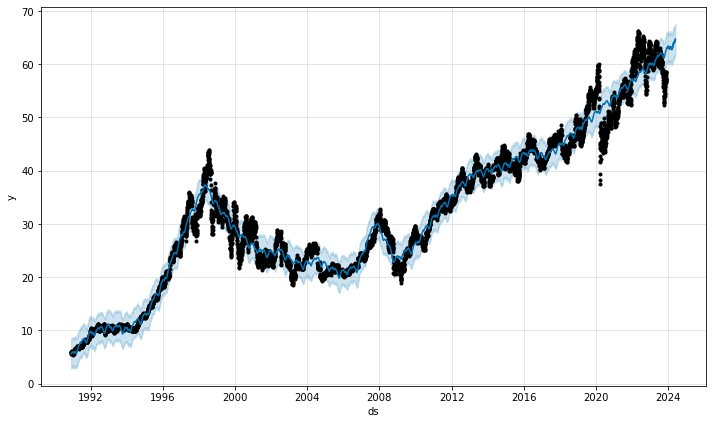

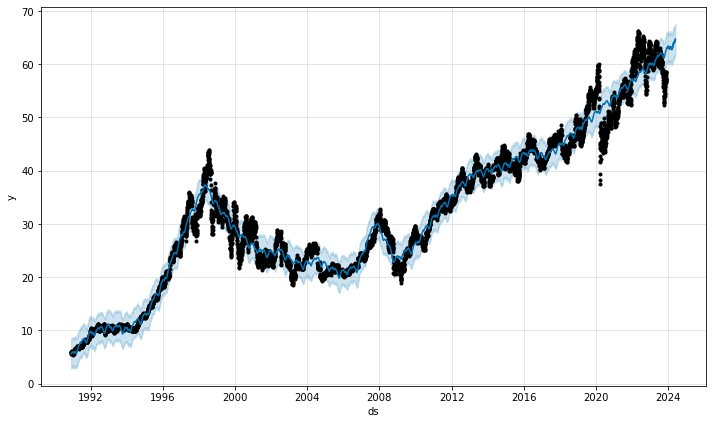

In [61]:
trend_plot = auto_model.plot(six_month_forecast)
trend_plot

In [62]:
from prophet.plot import plot_plotly

trend_plot = plot_plotly(auto_model, six_month_forecast)
trend_plot


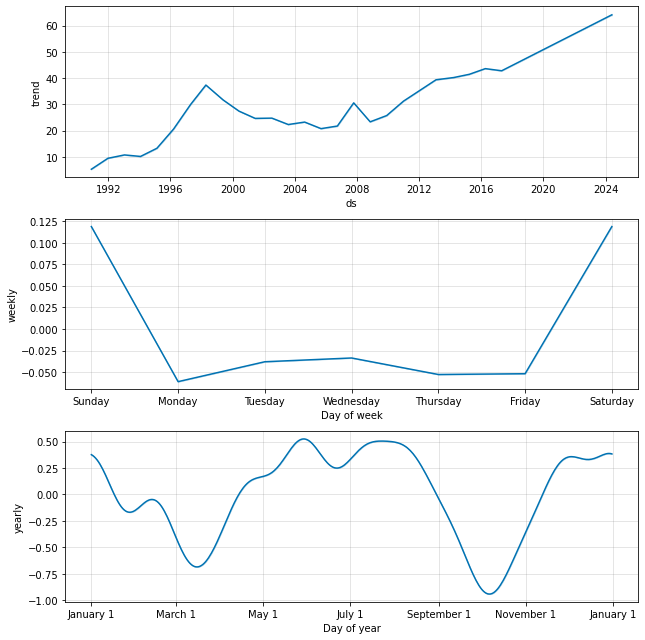

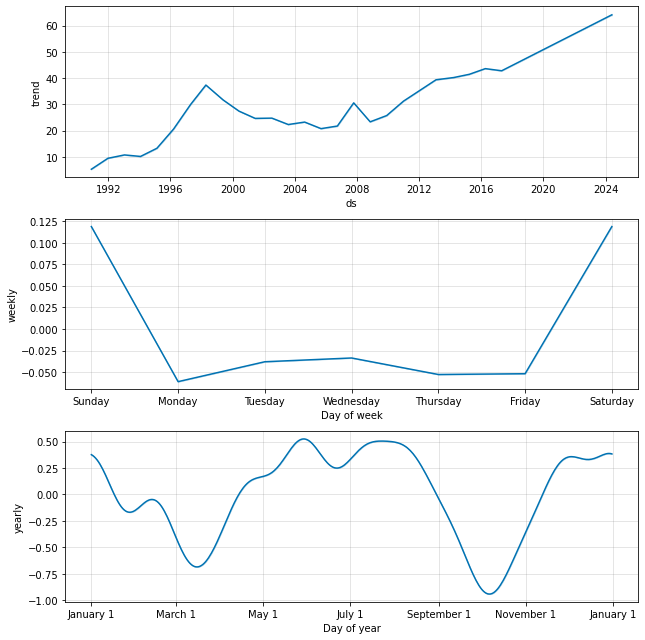

In [63]:
six_month_performance_plot = auto_model.plot_components(six_month_forecast)
six_month_performance_plot

[[<matplotlib.lines.Line2D at 0x223b54466d0>],

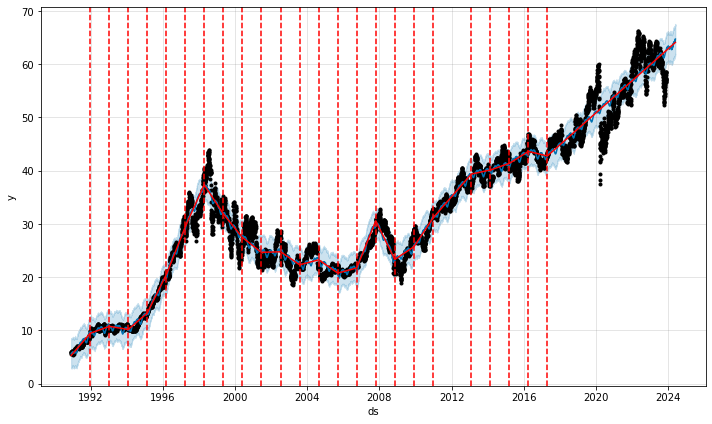

In [64]:
# Trends and seasonality
trend_plot = auto_model.plot(six_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, six_month_forecast)
trends_and_seasonality_plot

In [65]:
from prophet.diagnostics import cross_validation
six_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

20:57:59 - cmdstanpy - INFO - Chain [1] start processing
20:58:00 - cmdstanpy - INFO - Chain [1] done processing
20:58:00 - cmdstanpy - INFO - Chain [1] start processing
20:58:00 - cmdstanpy - INFO - Chain [1] done processing
20:58:01 - cmdstanpy - INFO - Chain [1] start processing
20:58:01 - cmdstanpy - INFO - Chain [1] done processing
20:58:01 - cmdstanpy - INFO - Chain [1] start processing
20:58:02 - cmdstanpy - INFO - Chain [1] done processing
20:58:02 - cmdstanpy - INFO - Chain [1] start processing
20:58:03 - cmdstanpy - INFO - Chain [1] done processing
20:58:03 - cmdstanpy - INFO - Chain [1] start processing
20:58:03 - cmdstanpy - INFO - Chain [1] done processing
20:58:04 - cmdstanpy - INFO - Chain [1] start processing
20:58:04 - cmdstanpy - INFO - Chain [1] done processing
20:58:04 - cmdstanpy - INFO - Chain [1] start processing
20:58:05 - cmdstanpy - INFO - Chain [1] done processing
20:58:05 - cmdstanpy - INFO - Chain [1] start processing
20:58:06 - cmdstanpy - INFO - Chain [1]

In [66]:
six_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.553112,10.003623,9.812500,1993-05-04
1,1993-05-06,9.795248,9.565559,10.021867,9.718750,1993-05-04
2,1993-05-07,9.804399,9.573299,10.029981,9.687500,1993-05-04
3,1993-05-10,9.884203,9.661586,10.114716,9.781250,1993-05-04
4,1993-05-11,9.885557,9.670416,10.108778,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,58.964672,66.599605,58.029999,2022-11-28
15346,2023-11-22,62.636896,59.027599,66.368814,58.419998,2022-11-28
15347,2023-11-24,62.650314,59.099939,66.484497,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.155461,66.369994,58.459999,2022-11-28


In [67]:
# Performance metrics
from prophet.diagnostics import performance_metrics
six_month_performance_df = performance_metrics(six_month_cv)
six_month_performance_df


,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.450996
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.450020
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.448581
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.447945
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.446754
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.761291
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.761812
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.764542
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.766682


#  Twelve month auto forecast

In [68]:
twelve_month_future = auto_model.make_future_dataframe(periods=12*30, freq='D')

In [69]:
twelve_month_forecast = auto_model.predict(twelve_month_future)

In [70]:
twelve_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8667,2024-11-18,65.655105,61.909523,69.400460,65.552389,63.627120,67.513936
8668,2024-11-19,65.712029,61.983848,69.089403,65.560620,63.620917,67.537203
8669,2024-11-20,65.748822,61.884556,69.351317,65.568852,63.614715,67.558994
8670,2024-11-21,65.760532,62.008755,69.534839,65.577084,63.608512,67.580785
8671,2024-11-22,65.790554,62.030302,69.535969,65.585315,63.602309,67.613388


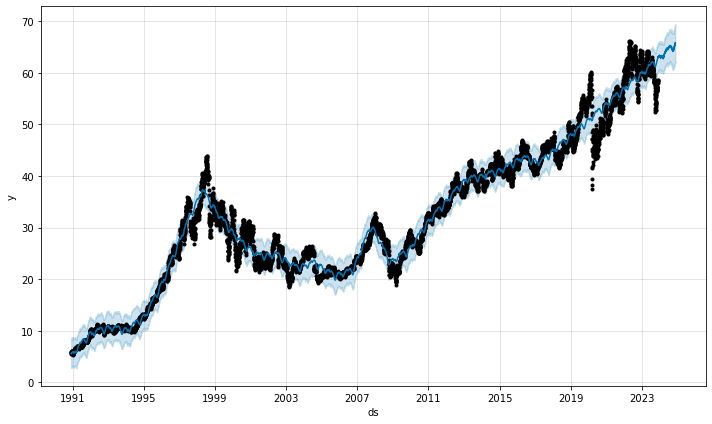

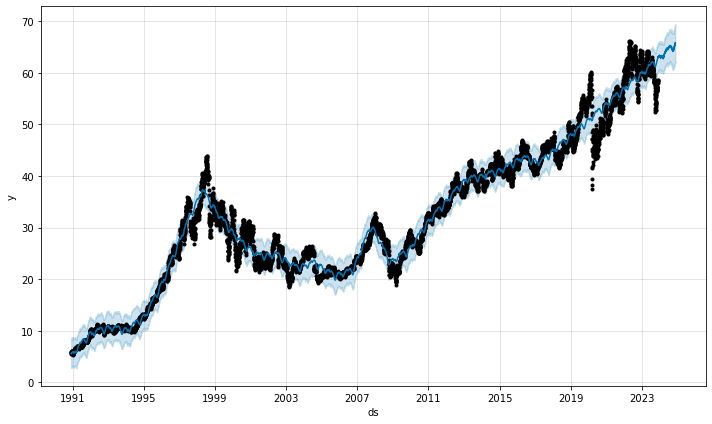

In [71]:
trend_plot = auto_model.plot(twelve_month_forecast)
trend_plot

In [72]:
from prophet.plot import plot_plotly

trend_plot = plot_plotly(auto_model, twelve_month_forecast)
trend_plot


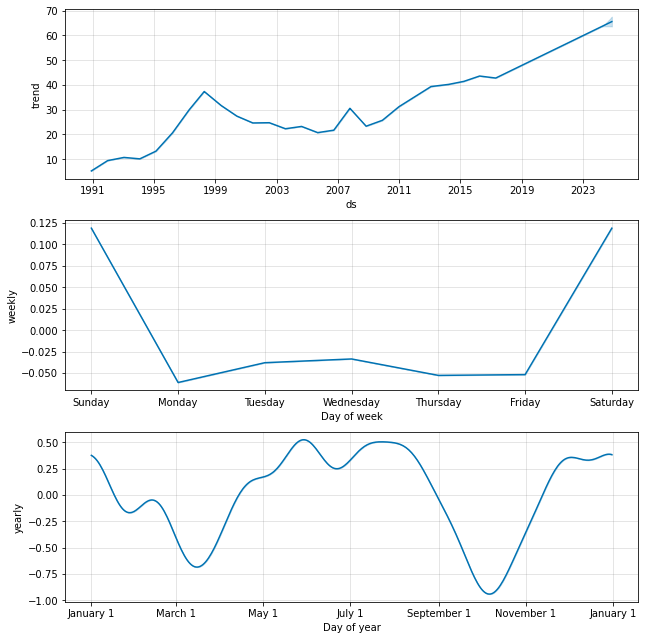

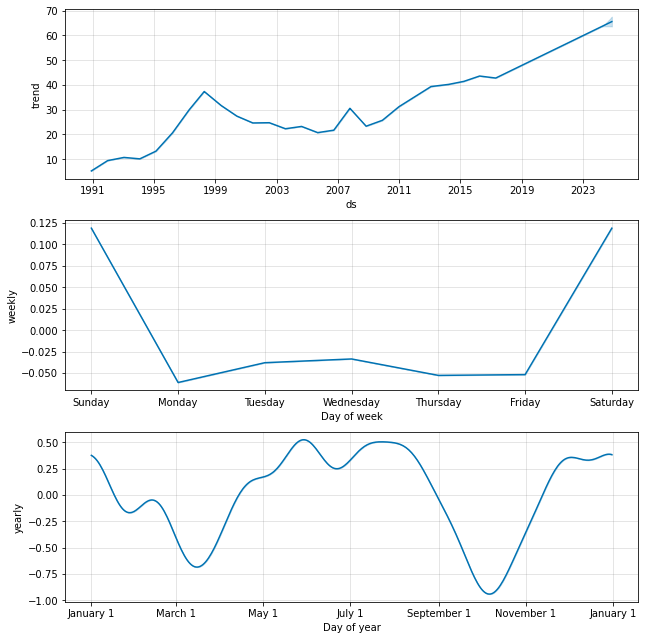

In [73]:
twelve_month_performance_plot = auto_model.plot_components(twelve_month_forecast)
twelve_month_performance_plot

[[<matplotlib.lines.Line2D at 0x223b7389070>],

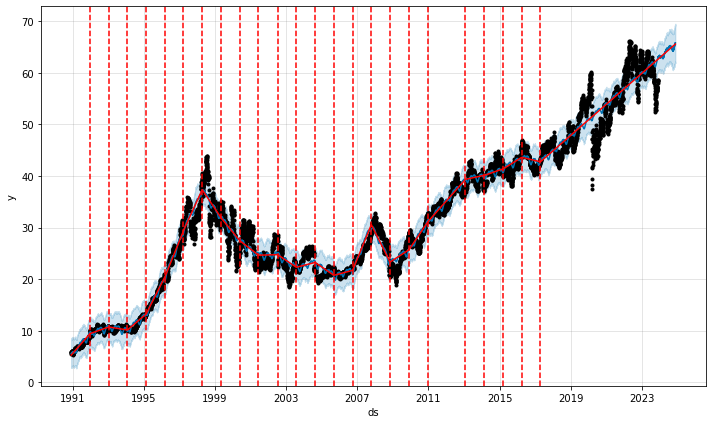

In [74]:
# Trends and seasonality
trend_plot = auto_model.plot(twelve_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, twelve_month_forecast)
trends_and_seasonality_plot

In [75]:
from prophet.diagnostics import cross_validation
twelve_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

21:00:19 - cmdstanpy - INFO - Chain [1] start processing
21:00:19 - cmdstanpy - INFO - Chain [1] done processing
21:00:20 - cmdstanpy - INFO - Chain [1] start processing
21:00:20 - cmdstanpy - INFO - Chain [1] done processing
21:00:20 - cmdstanpy - INFO - Chain [1] start processing
21:00:21 - cmdstanpy - INFO - Chain [1] done processing
21:00:21 - cmdstanpy - INFO - Chain [1] start processing
21:00:22 - cmdstanpy - INFO - Chain [1] done processing
21:00:22 - cmdstanpy - INFO - Chain [1] start processing
21:00:22 - cmdstanpy - INFO - Chain [1] done processing
21:00:23 - cmdstanpy - INFO - Chain [1] start processing
21:00:23 - cmdstanpy - INFO - Chain [1] done processing
21:00:24 - cmdstanpy - INFO - Chain [1] start processing
21:00:24 - cmdstanpy - INFO - Chain [1] done processing
21:00:24 - cmdstanpy - INFO - Chain [1] start processing
21:00:25 - cmdstanpy - INFO - Chain [1] done processing
21:00:25 - cmdstanpy - INFO - Chain [1] start processing
21:00:26 - cmdstanpy - INFO - Chain [1]

In [76]:
twelve_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.542710,9.961719,9.812500,1993-05-04
1,1993-05-06,9.795248,9.570443,10.018041,9.718750,1993-05-04
2,1993-05-07,9.804399,9.563500,10.041255,9.687500,1993-05-04
3,1993-05-10,9.884203,9.665580,10.107915,9.781250,1993-05-04
4,1993-05-11,9.885557,9.638743,10.112545,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,58.872636,66.337738,58.029999,2022-11-28
15346,2023-11-22,62.636896,59.506471,66.418897,58.419998,2022-11-28
15347,2023-11-24,62.650314,59.130173,66.415352,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.173641,66.786827,58.459999,2022-11-28


In [77]:
# Performance metrics
from prophet.diagnostics import performance_metrics
twelve_month_performance_df = performance_metrics(twelve_month_cv)
twelve_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.453602
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.452626
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.452179
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.451497
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.449360
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.775184
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.776640
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.778734
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.780704


#  Eighteen month auto forecast

In [78]:
eighteen_month_future = auto_model.make_future_dataframe(periods=18*30, freq='D')

In [79]:
eighteen_month_forecast = auto_model.predict(eighteen_month_future)

In [80]:
eighteen_month_forecast[['ds', 'yhat', 'yhat_lower',
          'yhat_upper', 'trend',
          'trend_lower', 'trend_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper,trend,trend_lower,trend_upper
8847,2025-05-17,67.515078,62.312776,72.986326,67.034092,62.392885,71.928008
8848,2025-05-18,67.543209,62.011745,73.307342,67.042323,62.387063,71.948245
8849,2025-05-19,67.391270,62.072014,72.743044,67.050555,62.376344,71.968482
8850,2025-05-20,67.441795,62.025840,73.186497,67.058787,62.362766,71.988719
8851,2025-05-21,67.472790,61.541931,72.824839,67.067018,62.358290,72.008956


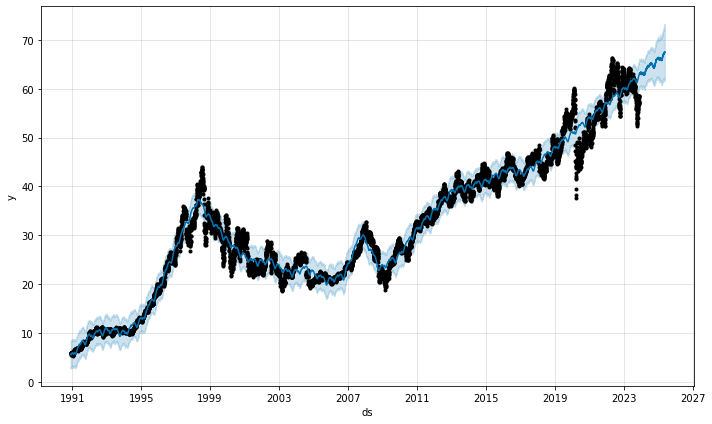

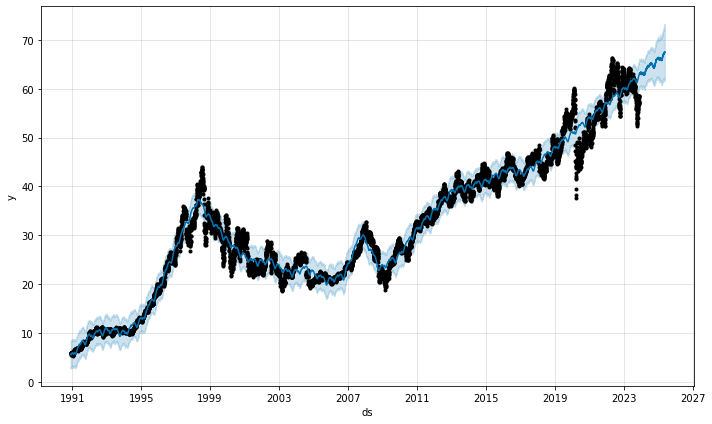

In [81]:
trend_plot = auto_model.plot(eighteen_month_forecast)
trend_plot

In [82]:
from prophet.plot import plot_plotly
trend_plot = plot_plotly(auto_model, eighteen_month_forecast)
trend_plot


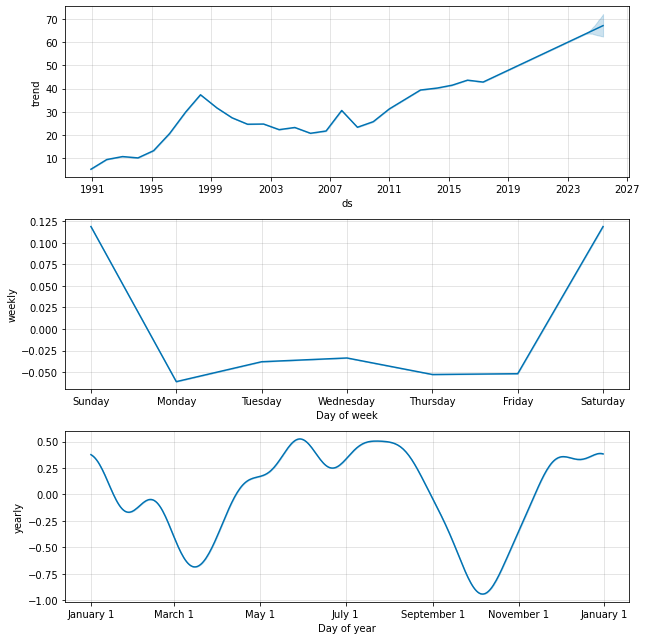

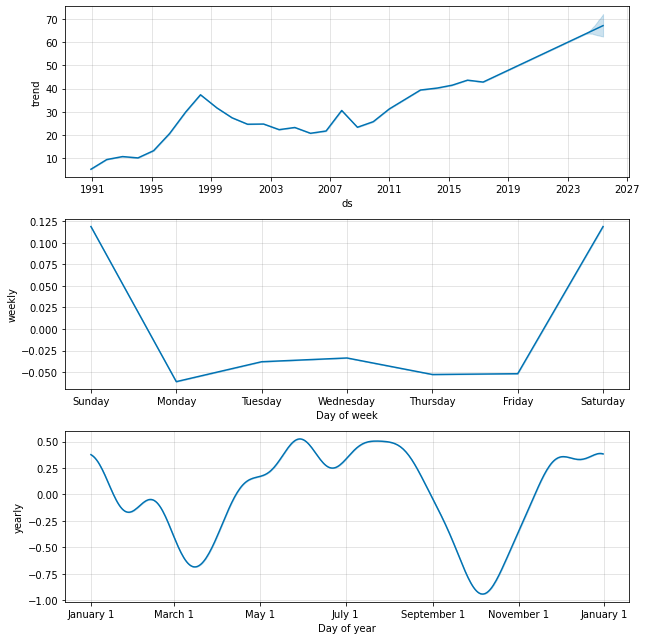

In [133]:
eighteen_month_performance_plot = auto_model.plot_components(eighteen_month_forecast)
eighteen_month_performance_plot

[[<matplotlib.lines.Line2D at 0x223b7529fd0>],

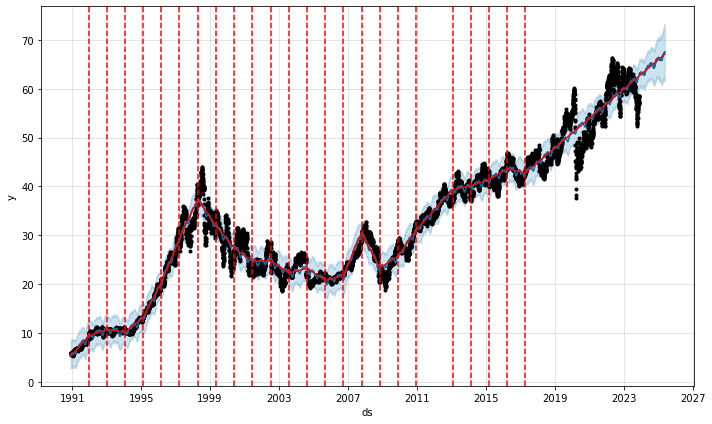

In [84]:
# Trends and seasonality
trend_plot = auto_model.plot(eighteen_month_forecast)
trends_and_seasonality_plot = add_changepoints_to_plot(trend_plot.gca(),
                                                       auto_model, eighteen_month_forecast)
trends_and_seasonality_plot

In [85]:
from prophet.diagnostics import cross_validation
eighteen_month_cv = cross_validation(auto_model, initial='730 days', period='180 days', horizon='365 days')

  0%|          | 0/61 [00:00<?, ?it/s]

21:02:47 - cmdstanpy - INFO - Chain [1] start processing
21:02:48 - cmdstanpy - INFO - Chain [1] done processing
21:02:48 - cmdstanpy - INFO - Chain [1] start processing
21:02:48 - cmdstanpy - INFO - Chain [1] done processing
21:02:49 - cmdstanpy - INFO - Chain [1] start processing
21:02:49 - cmdstanpy - INFO - Chain [1] done processing
21:02:49 - cmdstanpy - INFO - Chain [1] start processing
21:02:50 - cmdstanpy - INFO - Chain [1] done processing
21:02:50 - cmdstanpy - INFO - Chain [1] start processing
21:02:51 - cmdstanpy - INFO - Chain [1] done processing
21:02:51 - cmdstanpy - INFO - Chain [1] start processing
21:02:52 - cmdstanpy - INFO - Chain [1] done processing
21:02:52 - cmdstanpy - INFO - Chain [1] start processing
21:02:52 - cmdstanpy - INFO - Chain [1] done processing
21:02:53 - cmdstanpy - INFO - Chain [1] start processing
21:02:53 - cmdstanpy - INFO - Chain [1] done processing
21:02:53 - cmdstanpy - INFO - Chain [1] start processing
21:02:54 - cmdstanpy - INFO - Chain [1]

In [86]:
eighteen_month_cv

,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,1993-05-05,9.769613,9.557747,9.997083,9.812500,1993-05-04
1,1993-05-06,9.795248,9.568014,10.025120,9.718750,1993-05-04
2,1993-05-07,9.804399,9.579347,10.030691,9.687500,1993-05-04
3,1993-05-10,9.884203,9.674438,10.107547,9.781250,1993-05-04
4,1993-05-11,9.885557,9.656094,10.097563,10.031250,1993-05-04
...,...,...,...,...,...,...
15345,2023-11-21,62.616540,58.963947,66.157473,58.029999,2022-11-28
15346,2023-11-22,62.636896,58.795727,66.172475,58.419998,2022-11-28
15347,2023-11-24,62.650314,58.824086,66.379556,58.570000,2022-11-28
15348,2023-11-27,62.672143,59.002283,66.540633,58.459999,2022-11-28


In [87]:
# Performance metrics
from prophet.diagnostics import performance_metrics
eighteen_month_performance_df = performance_metrics(eighteen_month_cv)
eighteen_month_performance_df

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,37 days,8.344762,2.888730,2.252633,0.071284,0.060383,0.070818,0.453935
1,38 days,8.449034,2.906722,2.265322,0.071663,0.059807,0.071264,0.452626
2,39 days,8.590983,2.931038,2.283457,0.072080,0.060383,0.071744,0.451838
3,40 days,8.664594,2.943568,2.292896,0.072174,0.060632,0.071913,0.451202
4,41 days,8.706273,2.950639,2.298149,0.072286,0.061072,0.072059,0.450011
...,...,...,...,...,...,...,...,...
324,361 days,25.801404,5.079508,3.921880,0.128735,0.091685,0.126068,0.753685
325,362 days,25.916471,5.090822,3.931203,0.129245,0.091778,0.126490,0.753994
326,363 days,26.037184,5.102664,3.938288,0.129676,0.092898,0.126868,0.756724
327,364 days,26.230775,5.121599,3.949229,0.130141,0.092898,0.127286,0.759516


#  Predict KO 6, 12, 18 months with LSTM model

In [88]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense

In [89]:
coke_stock_df.set_index('ds', inplace=True)
coke_stock_df.head(), coke_df.tail()

(                   y
 ds                  
 1990-11-29  5.593750
 1990-11-30  5.781250
 1990-12-03  5.843750
 1990-12-04  5.859375
 1990-12-05  5.937500,
             Date      Close
 8307  2023-11-21  58.029999
 8308  2023-11-22  58.419998
 8309  2023-11-24  58.570000
 8310  2023-11-27  58.459999
 8311  2023-11-28  58.580002)

In [90]:
stock_data = coke_stock_df['y'].values.reshape(-1, 1)

In [91]:
# Normalize the data using Min-Max scaling
scaler = MinMaxScaler()
stock_data_scaled = scaler.fit_transform(stock_data)

In [92]:
# Function to create time series data with specified lookback
def create_time_series_data(data, lookback):
    X, y = [], []
    for i in range(len(data) - lookback):
        X.append(data[i:(i + lookback), 0])
        y.append(data[i + lookback, 0])
    return np.array(X), np.array(y)

In [93]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 60

In [94]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [95]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [96]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [97]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [98]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
194/194 [==============================] - 15s 58ms/step - loss: 0.0034
Epoch 2/50
194/194 [==============================] - 11s 56ms/step - loss: 3.0428e-04
Epoch 3/50
194/194 [==============================] - 10s 53ms/step - loss: 2.8702e-04
Epoch 4/50
194/194 [==============================] - 10s 52ms/step - loss: 2.6373e-04
Epoch 5/50
194/194 [==============================] - 10s 51ms/step - loss: 2.4263e-04
Epoch 6/50
194/194 [==============================] - 10s 51ms/step - loss: 2.2356e-04
Epoch 7/50
194/194 [==============================] - 10s 52ms/step - loss: 1.9443e-04
Epoch 8/50
194/194 [==============================] - 10s 52ms/step - loss: 1.5701e-04
Epoch 9/50
194/194 [==============================] - 10s 51ms/step - loss: 1.5706e-04
Epoch 10/50
194/194 [==============================] - 10s 52ms/step - loss: 1.4606e-04
Epoch 11/50
194/194 [==============================] - 10s 52ms/step - loss: 1.3353e-04
Epoch 12/50
194/194 [========================

In [99]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')


65/65 [==============================] - 2s 19ms/step - loss: 8.9870e-04
Test Loss: 0.000898703932762146


In [100]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)


1/1 [==============================] - 0s 25ms/step


In [101]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[56.22126154],
       [53.83182611],
       [52.13061107],
       [50.74798064],
       [49.56058029],
       [48.49646559],
       [47.52043124],
       [46.61488727],
       [45.76946318],
       [44.97668569],
       [44.23025636],
       [43.52447502],
       [42.85406217],
       [42.21422415],
       [41.60067861],
       [41.0096182 ],
       [40.4377686 ],
       [39.88229785]])

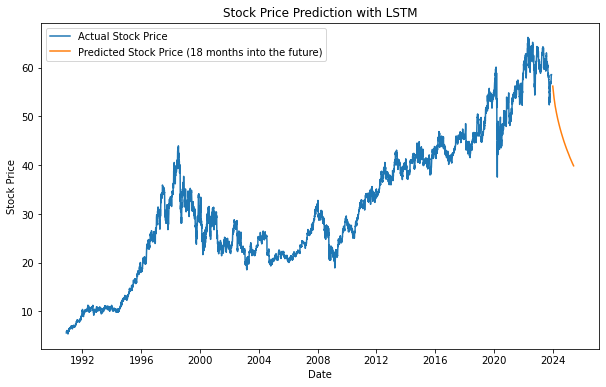

In [102]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [103]:
import plotly.graph_objects as go

In [104]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 31ms/step


In [105]:
coke_stock_df.tail()

,y
ds,
2023-11-21,58.029999
2023-11-22,58.419998
2023-11-24,58.570000
2023-11-27,58.459999
2023-11-28,58.580002


In [106]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 16ms/step


#  Try lookback of 180 in LSTM

In [107]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 180

In [108]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [109]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [110]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [111]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [112]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
191/191 [==============================] - 33s 155ms/step - loss: 0.0032
Epoch 2/50
191/191 [==============================] - 30s 155ms/step - loss: 3.1668e-04
Epoch 3/50
191/191 [==============================] - 30s 156ms/step - loss: 3.1662e-04
Epoch 4/50
191/191 [==============================] - 30s 155ms/step - loss: 2.7541e-04
Epoch 5/50
191/191 [==============================] - 30s 155ms/step - loss: 2.3341e-04
Epoch 6/50
191/191 [==============================] - 30s 156ms/step - loss: 2.0402e-04
Epoch 7/50
191/191 [==============================] - 30s 155ms/step - loss: 1.7937e-04
Epoch 8/50
191/191 [==============================] - 30s 156ms/step - loss: 1.8360e-04
Epoch 9/50
191/191 [==============================] - 30s 155ms/step - loss: 1.2995e-04
Epoch 10/50
191/191 [==============================] - 30s 155ms/step - loss: 1.3488e-04
Epoch 11/50
191/191 [==============================] - 30s 155ms/step - loss: 1.2152e-04
Epoch 12/50
191/191 [=============

In [113]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

64/64 [==============================] - 4s 52ms/step - loss: 1.6259e-04
Test Loss: 0.00016259138647001237


In [114]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)


1/1 [==============================] - 0s 33ms/step


In [115]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[58.13843316],
       [57.5912008 ],
       [57.21678953],
       [56.94891882],
       [56.74149434],
       [56.55776609],
       [56.38386081],
       [56.2191258 ],
       [56.06612105],
       [55.9262136 ],
       [55.79906621],
       [55.68335537],
       [55.5775219 ],
       [55.48022776],
       [55.39035252],
       [55.30700417],
       [55.22938135],
       [55.15684588]])

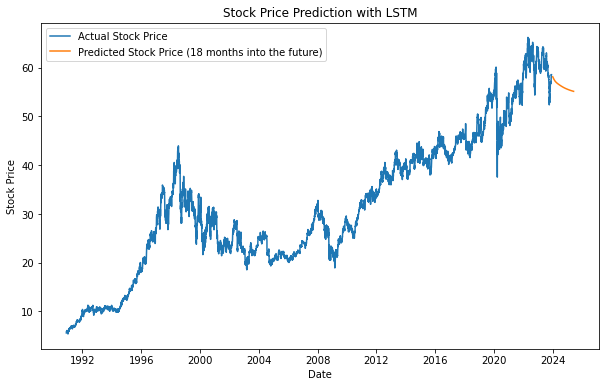

In [116]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [117]:
import plotly.graph_objects as go

In [118]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 47ms/step


In [119]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 42ms/step


#  Try lookback of 365

In [120]:
# Set the lookback period (relatively arbitrary; can experiment with different values)
lookback = 365

In [121]:
X, y = create_time_series_data(stock_data_scaled, lookback)

In [122]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=122, shuffle=False)

In [123]:
# Reshape the data for LSTM input shape (samples, time steps, features)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))

In [124]:
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], 1)))
model.add(LSTM(units=50, return_sequences=True))
model.add(LSTM(units=50))
model.add(Dense(units=1))
model.compile(optimizer='adam', loss='mean_squared_error')

In [125]:
model.fit(X_train, y_train, epochs=50, batch_size=32)

Epoch 1/50
187/187 [==============================] - 60s 303ms/step - loss: 0.0045
Epoch 2/50
187/187 [==============================] - 56s 300ms/step - loss: 3.3354e-04
Epoch 3/50
187/187 [==============================] - 55s 295ms/step - loss: 3.0533e-04
Epoch 4/50
187/187 [==============================] - 56s 297ms/step - loss: 2.6863e-04
Epoch 5/50
187/187 [==============================] - 58s 310ms/step - loss: 2.2610e-04
Epoch 6/50
187/187 [==============================] - 58s 309ms/step - loss: 1.9076e-04
Epoch 7/50
187/187 [==============================] - 58s 310ms/step - loss: 1.7166e-04
Epoch 8/50
187/187 [==============================] - 57s 303ms/step - loss: 1.6333e-04
Epoch 9/50
187/187 [==============================] - 56s 297ms/step - loss: 1.4341e-04
Epoch 10/50
187/187 [==============================] - 55s 296ms/step - loss: 1.3902e-04
Epoch 11/50
187/187 [==============================] - 56s 298ms/step - loss: 1.2584e-04
Epoch 12/50
187/187 [=============

In [126]:
loss = model.evaluate(X_test, y_test)
print(f'Test Loss: {loss}')

63/63 [==============================] - 7s 100ms/step - loss: 6.1639e-04
Test Loss: 0.0006163938669487834


In [127]:
# Forecast 6, 12, and 18 months into the future
future_months = [6, 12, 18]
for months in future_months:
    # Assuming the last available data is used to make predictions
    last_data_point = stock_data_scaled[-lookback:]
    future_dates = pd.date_range(start=coke_stock_df.index[-1], periods=months + 1, freq='M')[1:]

    for _ in range(months):
        # Reshape the data for prediction
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)

1/1 [==============================] - 0s 45ms/step


In [128]:
# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(last_data_point[-months:].reshape(-1, 1))
predicted_prices

array([[56.75534585],
       [54.63993091],
       [52.97004129],
       [51.62772165],
       [50.49742431],
       [49.515048  ],
       [48.6438971 ],
       [47.86125079],
       [47.15099129],
       [46.50047093],
       [45.89926847],
       [45.33874301],
       [44.81185641],
       [44.31283236],
       [43.83701139],
       [43.38069132],
       [42.94088065],
       [42.51516442]])

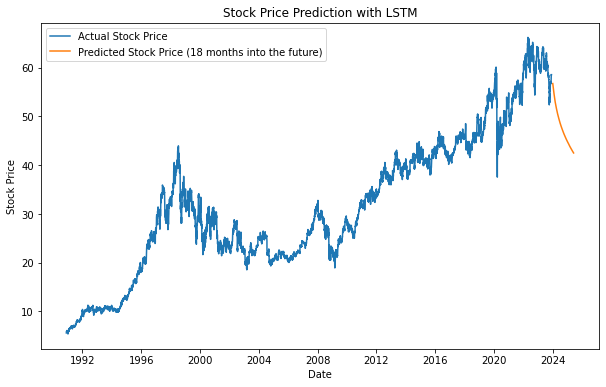

In [129]:
# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(coke_stock_df.index, coke_stock_df['y'], label='Actual Stock Price')
plt.plot(future_dates, predicted_prices, label=f'Predicted Stock Price ({months} months into the future)')
plt.title('Stock Price Prediction with LSTM')
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.legend()

In [130]:
import plotly.graph_objects as go

In [131]:
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions
# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)


# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()

1/1 [==============================] - 0s 36ms/step


In [132]:
import plotly.graph_objects as go

# Function to make predictions for future months
def make_predictions(model, last_data_point, lookback, future_months):
    predictions = []
    for _ in range(future_months):
        input_data = last_data_point[-lookback:].reshape(1, -1, 1)
        prediction = model.predict(input_data)
        last_data_point = np.append(last_data_point, prediction)
        predictions.append(prediction[0, 0])
    return predictions

# Make predictions for 18 months into the future
future_months = 18
predictions = make_predictions(model, last_data_point[-lookback:], lookback, future_months)

# Inverse transform the predicted data to get the actual stock prices
predicted_prices = scaler.inverse_transform(np.array(predictions).reshape(-1, 1))

# Create Plotly figure
fig = go.Figure()

# Plot actual stock prices
fig.add_trace(go.Scatter(x=coke_stock_df.index, y=coke_stock_df['y'], mode='lines', name='Actual Stock Price'))

# Plot predicted stock prices for the next 18 months
last_date = coke_stock_df.index[-1]
future_dates = pd.date_range(start=last_date, periods=future_months + 1, freq='MS')[1:].tolist()
fig.add_trace(go.Scatter(x=future_dates, y=predicted_prices.flatten(), mode='lines', name='Predicted Stock Price'))

# Update layout
fig.update_layout(
    title='Stock Price Prediction with LSTM',
    xaxis_title='Date',
    yaxis_title='Stock Price',
    legend=dict(x=0, y=1, traceorder='normal')
)

# Show the plot
fig.show()


1/1 [==============================] - 0s 42ms/step
